<a href="https://www.kaggle.com/code/sunilkumaradapa/ensemble-elixir-xgb-h2o?scriptVersionId=166830609" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

# Steel Plate Defect Prediction

# ****#  **** 🚀 If you found this notebook helpful or insightful, I'd be over the moon if you could spare a moment to give it an upvote! Your support means the world to me and encourages me to keep creating content like this. Thank you in advance! 🙏 🤝


 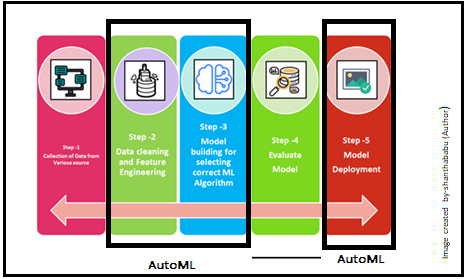

**Automated machine learning (AutoML):**
is the process of automating the end-to-end process of applying machine learning to real-world problems. In a typical machine learning application, the typical stages (and sub-stages) of work are the following:

Data preparation
data pre-processing
feature engineering
feature extraction
feature selection
Model selection
Hyperparameter optimization (to maximize the performance of the final model)
Many of these steps are often beyond the abilities of non-experts. AutoML was proposed as an artificial intelligence-based solution to the ever-growing challenge of applying machine learning.

**Some of the notable platforms tackling various stages of AutoML are the following:**

* **auto-sklearn** is a Bayesian hyperparameter optimization layer on top of scikit-learn.
* **TPOT (TeaPOT)** is a Python library that automatically creates and optimizes full machine learning pipelines using genetic programming.
* **TransmogrifAI** is a Scala/SparkML library created by Salesforce for automated data cleansing, feature engineering, model selection, and hyperparameter optimization.
***H2O AutoML** performs (simple) data preprocessing, automates the process of training a large selection of candidate models, tunes hyperparameters of the models and creates stacked ensembles.
* **H2O Driverless AI** is a commercial software package that automates lots of aspects of machine learning applications. It has a strong focus on automatic feature engineering.


In [1]:
%%capture
pip install iterative-stratification

# Import Libraries

In [2]:
#Import Libararies
import numpy as np, pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from ydata_profiling import ProfileReport
import h2o
import shap
from h2o.automl import H2OAutoML
from sklearn.model_selection import train_test_split
from xgboost import XGBClassifier
from catboost import CatBoostClassifier
from lightgbm import early_stopping,log_evaluation, Dataset
import lightgbm as lgb
from iterstrat.ml_stratifiers import MultilabelStratifiedKFold
from sklearn.metrics import roc_auc_score
from sklearn import set_config
import warnings
import optuna
from sklearn.preprocessing import PolynomialFeatures,OneHotEncoder
from sklearn.preprocessing import MultiLabelBinarizer
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from scipy.stats import mode
from sklearn.preprocessing import LabelEncoder
from pprint import pprint

warnings.filterwarnings('ignore')

sns.set_theme(style = 'white', palette = 'viridis')
pal = sns.color_palette('viridis')

pd.set_option('display.max_rows', 100)
set_config(transform_output = 'pandas')
pd.options.mode.chained_assignment = None


# Load the Data

In [3]:
train_data = pd.read_csv(r"/kaggle/input/playground-series-s4e3/train.csv")
test_data = pd.read_csv(r"/kaggle/input/playground-series-s4e3/test.csv")
#original data
orig_data = pd.read_csv("/kaggle/input/steel-plate-defects-predictions-original-csv/PlaygroundS4E3Original.csv")

In [4]:
""""# Combine fault columns into a single column
orig_data['Fault_Type'] = orig_data[['Pastry', 'Z_Scratch', 'K_Scatch', 'Stains', 'Dirtiness', 'Bumps', 'Other_Faults']].idxmax(axis=1)

# Replace 'no fault' for rows with all zeros in fault columns
no_fault_mask = (orig_data[['Pastry', 'Z_Scratch', 'K_Scatch', 'Stains', 'Dirtiness', 'Bumps', 'Other_Faults']] == 0).all(axis=1)
orig_data.loc[no_fault_mask, 'Fault_Type'] = 'No_Fault'

# Drop individual fault columns if not needed anymore
orig_data.drop(columns=['Pastry', 'Z_Scratch', 'K_Scatch', 'Stains', 'Dirtiness', 'Bumps', 'Other_Faults'], inplace=True)
orig_data.to_csv("Train_Original_Data.csv",index=False)
# Display the modified DataFrame
#print(train_data)"""


'"# Combine fault columns into a single column\norig_data[\'Fault_Type\'] = orig_data[[\'Pastry\', \'Z_Scratch\', \'K_Scatch\', \'Stains\', \'Dirtiness\', \'Bumps\', \'Other_Faults\']].idxmax(axis=1)\n\n# Replace \'no fault\' for rows with all zeros in fault columns\nno_fault_mask = (orig_data[[\'Pastry\', \'Z_Scratch\', \'K_Scatch\', \'Stains\', \'Dirtiness\', \'Bumps\', \'Other_Faults\']] == 0).all(axis=1)\norig_data.loc[no_fault_mask, \'Fault_Type\'] = \'No_Fault\'\n\n# Drop individual fault columns if not needed anymore\norig_data.drop(columns=[\'Pastry\', \'Z_Scratch\', \'K_Scatch\', \'Stains\', \'Dirtiness\', \'Bumps\', \'Other_Faults\'], inplace=True)\norig_data.to_csv("Train_Original_Data.csv",index=False)\n# Display the modified DataFrame\n#print(train_data)'

In [5]:
#original_data 
o_data = pd.read_csv(r'/kaggle/input/steel-plate-data-original/Train_Original_Data.csv')
o_data

,id,X_Minimum,X_Maximum,Y_Minimum,Y_Maximum,Pixels_Areas,X_Perimeter,Y_Perimeter,Sum_of_Luminosity,Minimum_of_Luminosity,...,Edges_X_Index,Edges_Y_Index,Outside_Global_Index,LogOfAreas,Log_X_Index,Log_Y_Index,Orientation_Index,Luminosity_Index,SigmoidOfAreas,Fault_Type
0,1,42,50,270900,270944,267,17,44,24220,76,...,0.4706,1.0000,1.0,2.4265,0.9031,1.6435,0.8182,-0.2913,0.5822,Pastry
1,2,645,651,2538079,2538108,108,10,30,11397,84,...,0.6000,0.9667,1.0,2.0334,0.7782,1.4624,0.7931,-0.1756,0.2984,Pastry
2,3,829,835,1553913,1553931,71,8,19,7972,99,...,0.7500,0.9474,1.0,1.8513,0.7782,1.2553,0.6667,-0.1228,0.2150,Pastry
3,4,853,860,369370,369415,176,13,45,18996,99,...,0.5385,1.0000,1.0,2.2455,0.8451,1.6532,0.8444,-0.1568,0.5212,Pastry
4,5,1289,1306,498078,498335,2409,60,260,246930,37,...,0.2833,0.9885,1.0,3.3818,1.2305,2.4099,0.9338,-0.1992,1.0000,Pastry
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1936,1937,249,277,325780,325796,273,54,22,35033,119,...,0.5185,0.7273,0.0,2.4362,1.4472,1.2041,-0.4286,0.0026,0.7254,Other_Faults
1937,1938,144,175,340581,340598,287,44,24,34599,112,...,0.7046,0.7083,0.0,2.4579,1.4914,1.2305,-0.4516,-0.0582,0.8173,Other_Faults
1938,1939,145,174,386779,386794,292,40,22,37572,120,...,0.7250,0.6818,0.0,2.4654,1.4624,1.1761,-0.4828,0.0052,0.7079,Other_Faults
1939,1940,137,170,422497,422528,419,97,47,52715,117,...,0.3402,0.6596,0.0,2.6222,1.5185,1.4914,-0.0606,-0.0171,0.9919,Other_Faults


In [6]:
#Load the data 
df_data1 = pd.read_csv(r"/kaggle/input/steel-plate-defect-prediction-dataset/Train_Data.csv")
df_data1

,id,X_Minimum,X_Maximum,Y_Minimum,Y_Maximum,Pixels_Areas,X_Perimeter,Y_Perimeter,Sum_of_Luminosity,Minimum_of_Luminosity,...,Edges_X_Index,Edges_Y_Index,Outside_Global_Index,LogOfAreas,Log_X_Index,Log_Y_Index,Orientation_Index,Luminosity_Index,SigmoidOfAreas,Fault_Type
0,0,584,590,909972,909977,16,8,5,2274,113,...,1.0000,1.0000,0.0,1.2041,0.9031,0.6990,-0.5000,-0.0104,0.1417,Stains
1,1,808,816,728350,728372,433,20,54,44478,70,...,0.2500,1.0000,1.0,2.6365,0.7782,1.7324,0.7419,-0.2997,0.9491,Other_Faults
2,2,39,192,2212076,2212144,11388,705,420,1311391,29,...,0.2363,0.3857,0.0,4.0564,2.1790,2.2095,-0.0105,-0.0944,1.0000,K_Scatch
3,3,781,789,3353146,3353173,210,16,29,3202,114,...,0.3750,0.9310,1.0,2.3222,0.7782,1.4314,0.6667,-0.0402,0.4025,K_Scatch
4,4,1540,1560,618457,618502,521,72,67,48231,82,...,0.2105,0.9861,1.0,2.7694,1.4150,1.8808,0.9158,-0.2455,0.9998,Other_Faults
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19214,19214,749,757,143210,143219,17,4,4,2193,122,...,1.0000,0.8000,0.0,1.2305,0.7782,0.6021,-0.1429,0.0044,0.2901,Stains
19215,19215,723,735,2488529,2488541,231,17,26,27135,104,...,0.7333,0.9216,1.0,2.3636,1.0414,1.4150,0.7222,-0.0989,0.5378,Other_Faults
19216,19216,6,31,1578055,1578129,780,114,98,71112,41,...,0.1862,0.9554,1.0,2.8921,1.4314,1.8692,0.7719,-0.4283,0.9997,Pastry
19217,19217,9,18,1713172,1713184,126,13,26,14808,88,...,0.7692,1.0000,1.0,2.1004,1.0414,1.4150,0.9610,-0.1162,0.3509,Other_Faults


In [7]:
#lets concat the Two Data Frames 
df_data = pd.concat([df_data1, o_data], axis=0)
df_data

,id,X_Minimum,X_Maximum,Y_Minimum,Y_Maximum,Pixels_Areas,X_Perimeter,Y_Perimeter,Sum_of_Luminosity,Minimum_of_Luminosity,...,Edges_X_Index,Edges_Y_Index,Outside_Global_Index,LogOfAreas,Log_X_Index,Log_Y_Index,Orientation_Index,Luminosity_Index,SigmoidOfAreas,Fault_Type
0,0,584,590,909972,909977,16,8,5,2274,113,...,1.0000,1.0000,0.0,1.2041,0.9031,0.6990,-0.5000,-0.0104,0.1417,Stains
1,1,808,816,728350,728372,433,20,54,44478,70,...,0.2500,1.0000,1.0,2.6365,0.7782,1.7324,0.7419,-0.2997,0.9491,Other_Faults
2,2,39,192,2212076,2212144,11388,705,420,1311391,29,...,0.2363,0.3857,0.0,4.0564,2.1790,2.2095,-0.0105,-0.0944,1.0000,K_Scatch
3,3,781,789,3353146,3353173,210,16,29,3202,114,...,0.3750,0.9310,1.0,2.3222,0.7782,1.4314,0.6667,-0.0402,0.4025,K_Scatch
4,4,1540,1560,618457,618502,521,72,67,48231,82,...,0.2105,0.9861,1.0,2.7694,1.4150,1.8808,0.9158,-0.2455,0.9998,Other_Faults
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1936,1937,249,277,325780,325796,273,54,22,35033,119,...,0.5185,0.7273,0.0,2.4362,1.4472,1.2041,-0.4286,0.0026,0.7254,Other_Faults
1937,1938,144,175,340581,340598,287,44,24,34599,112,...,0.7046,0.7083,0.0,2.4579,1.4914,1.2305,-0.4516,-0.0582,0.8173,Other_Faults
1938,1939,145,174,386779,386794,292,40,22,37572,120,...,0.7250,0.6818,0.0,2.4654,1.4624,1.1761,-0.4828,0.0052,0.7079,Other_Faults
1939,1940,137,170,422497,422528,419,97,47,52715,117,...,0.3402,0.6596,0.0,2.6222,1.5185,1.4914,-0.0606,-0.0171,0.9919,Other_Faults


# Explore the Data

*** id**: An identifier for each entry.
* **X_Minimum, X_Maximum, Y_Minimum, Y_Maximum**: These columns seem to represent the minimum and maximum coordinates of some bounding box or area.
* **Pixels_Areas**: The area of pixels in the given bounding box or area.
* **X_Perimeter, Y_Perimeter**: The perimeter along the x and y axes respectively.
* **Sum_of_Luminosity, Minimum_of_Luminosity**: These seem to be related to luminosity values.
* **Orientation_Index, Luminosity_Index, SigmoidOfAreas**: These appear to be numerical indices or values related to orientation, luminosity, and the sigmoid function applied to areas. 
* **Pastry, Z_Scratch, K_Scratch, Stains, Dirtiness, Bumps, Other_Faults**: These columns likely represent counts or indicators of different types of faults present in the data.

In [8]:
df_data.shape #train_data

(21160, 29)

In [9]:
#shape of train data 
test_data.shape

(12814, 28)

In [10]:
#test data
test_data

,id,X_Minimum,X_Maximum,Y_Minimum,Y_Maximum,Pixels_Areas,X_Perimeter,Y_Perimeter,Sum_of_Luminosity,Minimum_of_Luminosity,...,Outside_X_Index,Edges_X_Index,Edges_Y_Index,Outside_Global_Index,LogOfAreas,Log_X_Index,Log_Y_Index,Orientation_Index,Luminosity_Index,SigmoidOfAreas
0,19219,1015,1033,3826564,3826588,659,23,46,62357,67,...,0.0095,0.5652,1.0000,1.0,2.8410,1.1139,1.6628,0.6727,-0.2261,0.9172
1,19220,1257,1271,419960,419973,370,26,28,39293,92,...,0.0047,0.2414,1.0000,1.0,2.5682,0.9031,1.4472,0.9063,-0.1453,0.9104
2,19221,1358,1372,117715,117724,289,36,32,29386,101,...,0.0155,0.6000,0.7500,0.0,2.4609,1.3222,1.3222,-0.5238,-0.0435,0.6514
3,19222,158,168,232415,232440,80,10,11,8586,107,...,0.0037,0.8000,1.0000,1.0,1.9031,0.6990,1.0414,0.1818,-0.0738,0.2051
4,19223,559,592,544375,544389,140,19,15,15524,103,...,0.0158,0.8421,0.5333,0.0,2.1461,1.3222,1.1461,-0.5714,-0.0894,0.4170
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12809,32028,1101,1116,447943,447992,313,32,37,21603,79,...,0.0126,0.4063,0.9194,1.0,2.4955,1.2305,1.6335,0.7661,-0.3109,0.8894
12810,32029,1289,1306,3149494,3149542,59,9,18,5249,113,...,0.0052,0.7778,1.0000,1.0,1.7708,0.8451,1.2553,0.7222,-0.0448,0.1954
12811,32030,41,210,1587535,1587191,16584,796,522,1858162,24,...,0.1236,0.2199,0.4097,0.0,4.2525,2.2504,2.2672,-0.0629,-0.0801,1.0000
12812,32031,1329,1340,702237,702267,386,43,34,36875,66,...,0.0095,0.2407,1.0000,1.0,2.5866,1.1139,1.5911,0.8461,-0.2629,0.7844


In [11]:
#check the null values 
df_data.isnull().sum()#there is no null values 
#check test data for null values 
test_data.isnull().sum()

id                       0
X_Minimum                0
X_Maximum                0
Y_Minimum                0
Y_Maximum                0
Pixels_Areas             0
X_Perimeter              0
Y_Perimeter              0
Sum_of_Luminosity        0
Minimum_of_Luminosity    0
Maximum_of_Luminosity    0
Length_of_Conveyer       0
TypeOfSteel_A300         0
TypeOfSteel_A400         0
Steel_Plate_Thickness    0
Edges_Index              0
Empty_Index              0
Square_Index             0
Outside_X_Index          0
Edges_X_Index            0
Edges_Y_Index            0
Outside_Global_Index     0
LogOfAreas               0
Log_X_Index              0
Log_Y_Index              0
Orientation_Index        0
Luminosity_Index         0
SigmoidOfAreas           0
dtype: int64

In [12]:
#check for duplicated values 
df_data.duplicated().sum()
test_data.duplicated().sum()

0

# AutoEDA
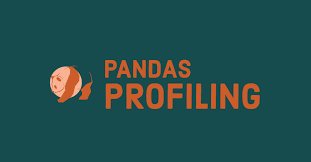
# Pandas Profiling:
* is an awesome python package for exploratory analysis (EDA). It extends pandas for statistical analysis summaries including correlations, missing values, distribution (quantile), and descriptive statistics

# Auto EDA

In [13]:
#Auto EDA
Auto_eda =ProfileReport(df_data,title="Auto EDA Report")

In [14]:
Auto_eda

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

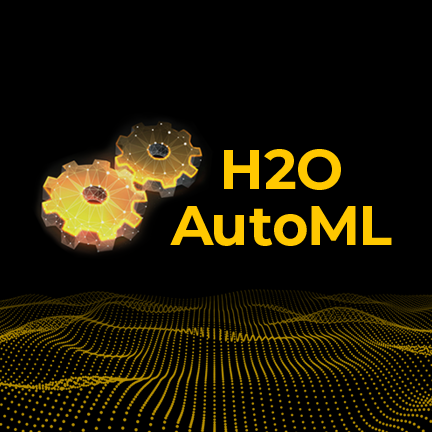

Links : [H2O Doc ](https://docs.h2o.ai/h2o/latest-stable/h2o-docs/automl.html)

In [15]:
#start H2o
h2o.init()

Checking whether there is an H2O instance running at http://localhost:54321..... not found.
Attempting to start a local H2O server...
  Java Version: openjdk version "11.0.21" 2023-10-17; OpenJDK Runtime Environment (build 11.0.21+9-post-Ubuntu-0ubuntu120.04); OpenJDK 64-Bit Server VM (build 11.0.21+9-post-Ubuntu-0ubuntu120.04, mixed mode, sharing)
  Starting server from /opt/conda/lib/python3.10/site-packages/h2o/backend/bin/h2o.jar
  Ice root: /tmp/tmpn14zyhdq
  JVM stdout: /tmp/tmpn14zyhdq/h2o_unknownUser_started_from_python.out
  JVM stderr: /tmp/tmpn14zyhdq/h2o_unknownUser_started_from_python.err
  Server is running at http://127.0.0.1:54321
Connecting to H2O server at http://127.0.0.1:54321 ... successful.


H2O_cluster_uptime:,03 secs
H2O_cluster_timezone:,Etc/UTC
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.44.0.3
H2O_cluster_version_age:,2 months and 21 days
H2O_cluster_name:,H2O_from_python_unknownUser_t13w51
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,7.500 Gb
H2O_cluster_total_cores:,4
H2O_cluster_allowed_cores:,4
H2O_cluster_status:,"locked, healthy"


# Load the data into H2O Frame

In [16]:
#Remove the unnecessary columns:
df_drop_train= df_data.drop(['id'],axis=1)
df_drop_test = test_data.drop(['id'],axis=1)


In [17]:
#load the data into H20 frame:
h2o_train = h2o.H2OFrame(df_drop_train)
h2o_test = h2o.H2OFrame(df_drop_test)

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%


In [18]:
h2o_train.describe(chunk_summary=True)

Rows:21160
Cols:28

Chunk compression summary: 
chunk_type    chunk_name                 count    count_percentage    size      size_percentage
------------  -------------------------  -------  ------------------  --------  -----------------
CBS           Binary                     2        7.14286             5.3 KB    0.375444
C1N           1-Byte Integers (w/o NAs)  3        10.7143             62.2 KB   4.40328
C1S           1-Byte Fractions           1        3.57143             20.7 KB   1.46887
C2            2-Byte Integers            6        21.4286             248.4 KB  17.5849
C2S           2-Byte Fractions           6        21.4286             248.5 KB  17.5915
C4            4-Byte Integers            4        14.2857             330.9 KB  23.4277
C4S           4-Byte Fractions           6        21.4286             496.4 KB  35.1482

Frame distribution summary: 
                 size    number_of_rows    number_of_chunks_per_column    number_of_chunks
---------------  ------  ----------------  -----------------------------  ------------------
127.0.0.1:54321  1.4 MB  21160             1                              28
mean             1.4 MB  21160             1                              28
min              1.4 MB  21160             1                              28
max              1.4 MB  21160             1                              28
stddev           0  B    0                 0                              0
total            1.4 MB  21160             1                              28

,X_Minimum,X_Maximum,Y_Minimum,Y_Maximum,Pixels_Areas,X_Perimeter,Y_Perimeter,Sum_of_Luminosity,Minimum_of_Luminosity,Maximum_of_Luminosity,Length_of_Conveyer,TypeOfSteel_A300,TypeOfSteel_A400,Steel_Plate_Thickness,Edges_Index,Empty_Index,Square_Index,Outside_X_Index,Edges_X_Index,Edges_Y_Index,Outside_Global_Index,LogOfAreas,Log_X_Index,Log_Y_Index,Orientation_Index,Luminosity_Index,SigmoidOfAreas,Fault_Type
type,int,int,int,int,int,int,int,int,int,int,int,int,int,int,real,real,real,real,real,real,real,real,real,real,real,real,real,enum
mins,0.0,4.0,6712.0,6724.0,2.0,2.0,1.0,250.0,0.0,37.0,1227.0,0.0,0.0,40.0,0.0,0.0,0.0083,0.0015,0.0144,0.0484,0.0,0.301,0.301,0.0,-0.991,-0.9989,0.119,
mean,697.1300567107724,741.3922022684302,1831495.3053875195,1828638.5614839257,1703.240831758038,97.14073724007552,65.85245746691892,193173.59111531262,84.78459357277879,128.78922495274128,1459.3332703213582,0.40245746691871453,0.5966446124763705,76.44470699432908,0.35099247637050934,0.40975839177693874,0.5741761086956578,0.03086177221172025,0.6143623015122848,0.8299844664461241,0.5904158790170166,2.4752095604914794,1.3147783270321372,1.3909781521739089,0.10095777032136044,-0.137732639413988,0.573142216209828,
maxs,1705.0,1713.0,12987661.0,12987692.0,152655.0,10449.0,18152.0,11591414.0,203.0,253.0,1794.0,1.0,1.0,300.0,0.9952,0.9439,1.0,0.8759,1.0,1.0,1.0,5.1837,3.0741,4.2587,0.9917,0.6421,1.0,
sigma,532.0545736890411,501.16009036942444,1892921.7462747907,1886265.9634040843,3884.8008509241276,192.51000771712162,161.18756595327375,448934.78632055834,29.121342051108147,14.672935939027552,145.474687555587,0.49040475107231163,0.4905825035141245,54.04244109179243,0.31731003526846624,0.12540844081608168,0.26051924808330573,0.04849323389422107,0.22438527255614862,0.22227610424106006,0.48208886760969755,0.7632203688927542,0.4691624682067341,0.4102740941595914,0.48892520230875586,0.12323745265637359,0.3329033913744134,
zeros,364,0,0,0,0,0,0,0,6,0,0,12644,8535,0,485,4,0,0,0,0,8268,0,0,5,826,2,0,
missing,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0,584.0,590.0,909972.0,909977.0,16.0,8.0,5.0,2274.0,113.0,140.0,1358.0,0.0,1.0,50.0,0.7393,0.4,0.5,0.0059,1.0,1.0,0.0,1.2041,0.9031,0.699,-0.5,-0.0104,0.1417,Stains
1,808.0,816.0,728350.0,728372.0,433.0,20.0,54.0,44478.0,70.0,111.0,1687.0,1.0,0.0,80.0,0.7772,0.2878,0.2581,0.0044,0.25,1.0,1.0,2.6365,0.7782,1.7324,0.7419,-0.2997,0.9491,Other_Faults
2,39.0,192.0,2212076.0,2212144.0,11388.0,705.0,420.0,1311391.0,29.0,141.0,1400.0,0.0,1.0,40.0,0.0557,0.5282,0.9895,0.1077,0.2363,0.3857,0.0,4.0564,2.179,2.2095,-0.0105,-0.0944,1.0,K_Scatch


# Split Train and Test

In [19]:
#Here response & predictor column by saving them x and y
response= "Fault_Type" #response
features= h2o_train.columns
features.remove(response)


# Run AutoML (H2O)

 [Parameters H2o](https://docs.h2o.ai/h2o/latest-stable/h2o-docs/parameters.html) ..check in Documentations for more parameters

# Here are some key parameters commonly used in H2O AutoML:

*** max_runtime_secs**: Specifies the maximum time in seconds that the AutoML process should run.
* **max_models**: Sets the maximum number of models to be trained by AutoML.
* **stopping_metric**: Determines the metric used to select the best models. Common options include 'AUC', 'logloss', 'RMSE', 'mae', etc. 
* **stopping_rounds**: Defines the number of consecutive AutoML iterations without improvement on the stopping_metric before the process stops. 
* **seed**: Sets the random seed for reproducibility. 
* **nfolds**: Specifies the number of cross-validation folds to use during model training. 
* **include_algos**: A list of algorithms to include in the AutoML process. If provided, only the specified algorithms will be considered.
* **exclude_algos**: A list of algorithms to exclude from the AutoML process.
* **sort_metric**: Determines the metric used to rank models. It can be different from the stopping_metric and is often used for sorting the leaderboard. 
* **balance_classes**: Specifies whether to balance class distribution in the training dataset.

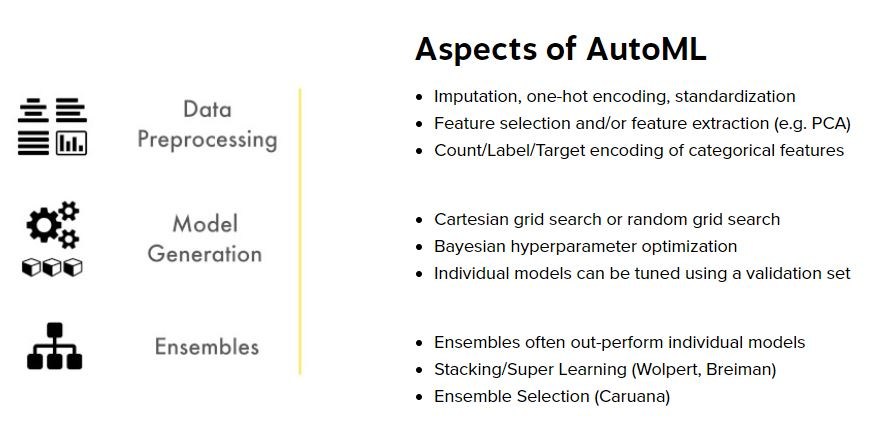

In [20]:
AML = H2OAutoML(nfolds=5,distribution="multinomial",keep_cross_validation_models=True,keep_cross_validation_predictions=True,balance_classes=True,max_models=None,max_runtime_secs=1300,seed=1234)
AML.train(x=features,y=response,training_frame=h2o_train)

AutoML progress: |███████████████████████████████████████████████████████████████| (done) 100%


key,value
Stacking strategy,cross_validation
Number of base models (used / total),8/8
# GBM base models (used / total),4/4
# XGBoost base models (used / total),2/2
# GLM base models (used / total),1/1
# DRF base models (used / total),1/1
Metalearner algorithm,GLM
Metalearner fold assignment scheme,Random
Metalearner nfolds,5
Metalearner fold_column,None


# LeaderBoard

In [21]:
#lets see the leaderboard
LB=AML.leaderboard
LB.head()

model_id,mean_per_class_error,logloss,rmse,mse
StackedEnsemble_AllModels_1_AutoML_1_20240313_131255,0.482796,0.996116,0.58408,0.34115
StackedEnsemble_BestOfFamily_1_AutoML_1_20240313_131255,0.484494,1.00072,0.585282,0.342555
StackedEnsemble_BestOfFamily_2_AutoML_1_20240313_131255,0.487812,1.00115,0.586195,0.343625
XGBoost_1_AutoML_1_20240313_131255,0.498752,1.07685,0.590226,0.348367
GBM_2_AutoML_1_20240313_131255,0.505019,1.03796,0.582545,0.339359
XGBoost_2_AutoML_1_20240313_131255,0.505072,1.0708,0.587152,0.344747
GBM_1_AutoML_1_20240313_131255,0.512968,1.04903,0.580192,0.336623
GBM_3_AutoML_1_20240313_131255,0.519591,1.05776,0.579978,0.336375
XGBoost_3_AutoML_1_20240313_131255,0.527861,1.58488,0.781778,0.611177
GBM_4_AutoML_1_20240313_131255,0.544349,1.11114,0.579992,0.336391


In [22]:
#save the top model 
top_model =AML.leader

# Save the Model

In [23]:
#save the model
save_model =h2o.save_model(top_model,path="/kaggle/working/",force=True)

# Submission

In [24]:
loaded_model = h2o.load_model(path=save_model)#loaded the leader model
predictions=loaded_model.predict(h2o_test)#predictions on test data
predictions_df = predictions.as_data_frame()
test_data_with_ids = pd.read_csv("/kaggle/input/playground-series-s4e3/test.csv")
test_id = test_data_with_ids['id']
sub = predictions_df.drop(['predict','No_Fault'],axis=1)# sub 

stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%
Export File progress: |██████████████████████████████████████████████████████████| (done) 100%


# XGBOOST-- OOF preds

In [25]:
data = pd.read_csv('/kaggle/input/playground-series-s4e3/train.csv',low_memory=False)
data.head()

,id,X_Minimum,X_Maximum,Y_Minimum,Y_Maximum,Pixels_Areas,X_Perimeter,Y_Perimeter,Sum_of_Luminosity,Minimum_of_Luminosity,...,Orientation_Index,Luminosity_Index,SigmoidOfAreas,Pastry,Z_Scratch,K_Scatch,Stains,Dirtiness,Bumps,Other_Faults
0,0,584,590,909972,909977,16,8,5,2274,113,...,-0.5000,-0.0104,0.1417,0,0,0,1,0,0,0
1,1,808,816,728350,728372,433,20,54,44478,70,...,0.7419,-0.2997,0.9491,0,0,0,0,0,0,1
2,2,39,192,2212076,2212144,11388,705,420,1311391,29,...,-0.0105,-0.0944,1.0000,0,0,1,0,0,0,0
3,3,781,789,3353146,3353173,210,16,29,3202,114,...,0.6667,-0.0402,0.4025,0,0,1,0,0,0,0
4,4,1540,1560,618457,618502,521,72,67,48231,82,...,0.9158,-0.2455,0.9998,0,0,0,0,0,0,1


In [26]:
original = pd.read_csv('/kaggle/input/steel-plate-defects-predictions-original-csv/PlaygroundS4E3Original.csv',low_memory=False)
original.head()

,id,X_Minimum,X_Maximum,Y_Minimum,Y_Maximum,Pixels_Areas,X_Perimeter,Y_Perimeter,Sum_of_Luminosity,Minimum_of_Luminosity,...,Orientation_Index,Luminosity_Index,SigmoidOfAreas,Pastry,Z_Scratch,K_Scatch,Stains,Dirtiness,Bumps,Other_Faults
0,1,42,50,270900,270944,267,17,44,24220,76,...,0.8182,-0.2913,0.5822,1,0,0,0,0,0,0
1,2,645,651,2538079,2538108,108,10,30,11397,84,...,0.7931,-0.1756,0.2984,1,0,0,0,0,0,0
2,3,829,835,1553913,1553931,71,8,19,7972,99,...,0.6667,-0.1228,0.2150,1,0,0,0,0,0,0
3,4,853,860,369370,369415,176,13,45,18996,99,...,0.8444,-0.1568,0.5212,1,0,0,0,0,0,0
4,5,1289,1306,498078,498335,2409,60,260,246930,37,...,0.9338,-0.1992,1.0000,1,0,0,0,0,0,0


In [27]:
data = pd.concat([data,original]).drop('id',axis=1).drop_duplicates()
data.head()

,X_Minimum,X_Maximum,Y_Minimum,Y_Maximum,Pixels_Areas,X_Perimeter,Y_Perimeter,Sum_of_Luminosity,Minimum_of_Luminosity,Maximum_of_Luminosity,...,Orientation_Index,Luminosity_Index,SigmoidOfAreas,Pastry,Z_Scratch,K_Scatch,Stains,Dirtiness,Bumps,Other_Faults
0,584,590,909972,909977,16,8,5,2274,113,140,...,-0.5000,-0.0104,0.1417,0,0,0,1,0,0,0
1,808,816,728350,728372,433,20,54,44478,70,111,...,0.7419,-0.2997,0.9491,0,0,0,0,0,0,1
2,39,192,2212076,2212144,11388,705,420,1311391,29,141,...,-0.0105,-0.0944,1.0000,0,0,1,0,0,0,0
3,781,789,3353146,3353173,210,16,29,3202,114,134,...,0.6667,-0.0402,0.4025,0,0,1,0,0,0,0
4,1540,1560,618457,618502,521,72,67,48231,82,111,...,0.9158,-0.2455,0.9998,0,0,0,0,0,0,1


In [28]:
label_cols = ['Pastry','Z_Scratch','K_Scatch','Stains','Dirtiness','Bumps','Other_Faults']
data = data[data[label_cols].sum(axis=1) <= 1]

In [29]:
test = pd.read_csv('/kaggle/input/playground-series-s4e3/test.csv',low_memory=False)
test.head()

,id,X_Minimum,X_Maximum,Y_Minimum,Y_Maximum,Pixels_Areas,X_Perimeter,Y_Perimeter,Sum_of_Luminosity,Minimum_of_Luminosity,...,Outside_X_Index,Edges_X_Index,Edges_Y_Index,Outside_Global_Index,LogOfAreas,Log_X_Index,Log_Y_Index,Orientation_Index,Luminosity_Index,SigmoidOfAreas
0,19219,1015,1033,3826564,3826588,659,23,46,62357,67,...,0.0095,0.5652,1.0000,1.0,2.8410,1.1139,1.6628,0.6727,-0.2261,0.9172
1,19220,1257,1271,419960,419973,370,26,28,39293,92,...,0.0047,0.2414,1.0000,1.0,2.5682,0.9031,1.4472,0.9063,-0.1453,0.9104
2,19221,1358,1372,117715,117724,289,36,32,29386,101,...,0.0155,0.6000,0.7500,0.0,2.4609,1.3222,1.3222,-0.5238,-0.0435,0.6514
3,19222,158,168,232415,232440,80,10,11,8586,107,...,0.0037,0.8000,1.0000,1.0,1.9031,0.6990,1.0414,0.1818,-0.0738,0.2051
4,19223,559,592,544375,544389,140,19,15,15524,103,...,0.0158,0.8421,0.5333,0.0,2.1461,1.3222,1.1461,-0.5714,-0.0894,0.4170


In [30]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 21139 entries, 0 to 1940
Data columns (total 34 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   X_Minimum              21139 non-null  int64  
 1   X_Maximum              21139 non-null  int64  
 2   Y_Minimum              21139 non-null  int64  
 3   Y_Maximum              21139 non-null  int64  
 4   Pixels_Areas           21139 non-null  int64  
 5   X_Perimeter            21139 non-null  int64  
 6   Y_Perimeter            21139 non-null  int64  
 7   Sum_of_Luminosity      21139 non-null  int64  
 8   Minimum_of_Luminosity  21139 non-null  int64  
 9   Maximum_of_Luminosity  21139 non-null  int64  
 10  Length_of_Conveyer     21139 non-null  int64  
 11  TypeOfSteel_A300       21139 non-null  int64  
 12  TypeOfSteel_A400       21139 non-null  int64  
 13  Steel_Plate_Thickness  21139 non-null  int64  
 14  Edges_Index            21139 non-null  float64
 15  Empty_In

In [31]:
class Model:
    def __init__(self, train, test):
        self.train = train
        self.test = test
        self.model_dict = dict()
        self.test_predict_list = list()
        
    def fit(self,params):
        target_col = ['Pastry','Z_Scratch','K_Scatch','Stains','Dirtiness','Bumps','Other_Faults']
        drop_col = ['id']
        
        train_cols = [col for col in self.train.columns.to_list() if col not in target_col + drop_col]
        scores = list()
        
        
        for i in range(4):
            mskf = MultilabelStratifiedKFold(n_splits=20, shuffle=True)
            oof_valid_preds = np.zeros((self.train[train_cols].shape[0], len(target_col)))
                
            for fold, (train_idx, valid_idx) in enumerate(mskf.split(self.train[train_cols], self.train[target_col])):
                X_train, y_train = self.train[train_cols].iloc[train_idx], self.train[target_col].iloc[train_idx]
                X_valid, y_valid = self.train[train_cols].iloc[valid_idx], self.train[target_col].iloc[valid_idx]
                
                model = XGBClassifier(random_state=i+fold,**params)
                    
                model.fit(X_train, y_train, eval_set=[(X_valid, y_valid)], 
                          early_stopping_rounds=250,verbose=False)
                    
                valid_preds = model.predict_proba(X_valid)
                oof_valid_preds[valid_idx] = valid_preds
                test_predict = model.predict_proba(self.test[train_cols])
                self.test_predict_list.append(test_predict)
                score = roc_auc_score(y_valid, valid_preds, multi_class="ova")
                self.model_dict[f'fold_{fold}'] = model
                    
            oof_score = roc_auc_score(self.train[target_col], oof_valid_preds, multi_class="ovr")
            print(f"The OOF auc score for iteration {i+1} is {oof_score}")
            scores.append(oof_score)
        return scores,self.test_predict_list
    
    def objective(self,trial):
        target_col = ['Pastry','Z_Scratch','K_Scatch','Stains','Dirtiness','Bumps','Other_Faults']
        drop_col = ['id']
        test_predict_list = list()
        model_dict = dict()
        
        train_cols = [col for col in self.train.columns.to_list() if col not in target_col + drop_col]
        scores = list()
        params = {'grow_policy': 'depthwise',
                  #'num_class':7,
                      'n_estimators': trial.suggest_int('n_estimators', 500, 2000), 
                       'learning_rate': trial.suggest_loguniform('learning_rate', 1e-5, 1), 
                       'gamma': trial.suggest_uniform('gamma', 0.1, 1), 
                       'subsample': trial.suggest_uniform('subsample', 0.5, 1),
                       'colsample_bytree': trial.suggest_uniform('colsample_bytree', 0.3, 1), 
                       'max_depth': trial.suggest_int('max_depth', 5, 30), 
                       'min_child_weight': trial.suggest_int('min_child_weight', 1, 25), 
                       'reg_lambda': trial.suggest_loguniform('reg_lambda', 1e-8, 10),
                       'reg_alpha': trial.suggest_loguniform('reg_alpha', 1e-8, 10),
                       'booster':'gbtree',
                       'verbosity':0,
                       'device_type': 'cuda','tree_method': 'gpu_hist'
                        }
        
        for i in range(1):
            mskf = MultilabelStratifiedKFold(n_splits=5, shuffle=True)
            oof_valid_preds = np.zeros((self.train[train_cols].shape[0], len(target_col)))
                
            for fold, (train_idx, valid_idx) in enumerate(mskf.split(self.train[train_cols], self.train[target_col])):
                X_train, y_train = self.train[train_cols].iloc[train_idx], self.train[target_col].iloc[train_idx]
                X_valid, y_valid = self.train[train_cols].iloc[valid_idx], self.train[target_col].iloc[valid_idx]
                
                model = XGBClassifier(random_state=i+fold,**params)
                    
                model.fit(X_train, y_train, eval_set=[(X_valid, y_valid)], early_stopping_rounds=100,verbose=False)
                    
                valid_preds = model.predict_proba(X_valid)
                oof_valid_preds[valid_idx] = valid_preds
                test_predict = model.predict_proba(self.test[train_cols])
                test_predict_list.append(test_predict)
                score = roc_auc_score(y_valid, valid_preds, multi_class="ovr")
                model_dict[f'fold_{fold}'] = model
                    
            oof_score = roc_auc_score(self.train[target_col], oof_valid_preds, multi_class="ovr")
            #print(f"The OOF auc score for iteration {i+1} is {oof_score}")
            scores.append(oof_score)
        return np.mean(np.array(scores))
    
    def find_params(self):
        study = optuna.create_study(direction='maximize')
        study.optimize(self.objective,250)

        best_params = study.best_params
        return best_params

In [32]:
#model = Model(data,test)
#model.find_params()

In [33]:
params1 = {'grow_policy': 'depthwise',
                  'n_estimators': 1713, 
                  'learning_rate': 0.00676793896727872, 
                  'gamma': 0.4425433619561816, 
                  'subsample': 0.6782713902375049, 
                  'colsample_bytree': 0.38371870139739117, 
                  'max_depth': 5, 
                  'min_child_weight': 4, 
                  'reg_lambda': 1.7864788262454325e-06, 
                  'reg_alpha': 0.5400111178318557,
                  'booster':'gbtree',
                  #'objective':'multi:softmax',
                  'verbosity': 0 ,#'device_type': 'cuda','tree_method': 'gpu_hist'
            }
params2 = { 'n_estimators':1800,
            'learning_rate': 0.006,
            'gamma': 0.44,
            'subsample': 0.7,
            'colsample_bytree': 0.38,
            'max_depth': 5,
            'min_child_weight': 4,
            'reg_lambda': 1.8e-06,
            'reg_alpha': 0.54,
            'booster':'gbtree',
           'grow_policy': 'depthwise',
            'verbosity': 0 ,#'device_type': 'cuda','tree_method': 'gpu_hist',
          }
          

In [34]:
model = Model(data,test)
scores1,preds1 = model.fit(params1)
print(f'The average roc-auc score is {np.mean(scores1)}')

model = Model(data,test)
scores2,preds2 = model.fit(params2)
print(f'The average roc-auc score is {np.mean(scores2)}')

The OOF auc score for iteration 1 is 0.8986388659001932
The OOF auc score for iteration 2 is 0.8982853555125102
The OOF auc score for iteration 3 is 0.8980475442653112
The OOF auc score for iteration 4 is 0.8981506504372818
The average roc-auc score is 0.898280604028824
The OOF auc score for iteration 1 is 0.8981357641055975
The OOF auc score for iteration 2 is 0.8982427024819114
The OOF auc score for iteration 3 is 0.8982458555970766
The OOF auc score for iteration 4 is 0.8984292265951146
The average roc-auc score is 0.898263387194925


In [35]:
predictions1 = np.mean(preds1,axis=0)
predictions2 = np.mean(preds2,axis=0)
ensemble_preds = (predictions1+predictions2+sub)/3
output_file = pd.DataFrame({"id": test_id,
                             "Pastry": ensemble_preds['Pastry'],
                             "Z_Scratch": ensemble_preds['Z_Scratch'],
                             "K_Scatch": ensemble_preds['K_Scatch'],
                             "Stains": ensemble_preds['Stains'],
                             "Dirtiness": ensemble_preds['Dirtiness'],
                             "Bumps": ensemble_preds['Bumps'],
                             "Other_Faults": ensemble_preds['Other_Faults'],
                             })
output_file.to_csv("submit_file1.csv", index=False)# csv file

In [36]:
output_file

,id,Pastry,Z_Scratch,K_Scatch,Stains,Dirtiness,Bumps,Other_Faults
0,19219,0.140618,0.227184,0.003020,0.119014,0.008075,0.447636,0.132478
1,19220,0.170928,0.225237,0.005259,0.104695,0.075089,0.234685,0.127264
2,19221,0.005004,0.352841,0.041304,0.198086,0.022876,0.084190,0.191632
3,19222,0.022382,0.288077,0.000624,0.271299,0.004220,0.265617,0.138481
4,19223,0.005544,0.230957,0.000740,0.417391,0.003099,0.192208,0.128130
...,...,...,...,...,...,...,...,...
12809,32028,0.045213,0.295258,0.001948,0.126296,0.065918,0.128680,0.161994
12810,32029,0.108505,0.266172,0.020403,0.140680,0.037660,0.161844,0.175901
12811,32030,0.000349,0.042821,0.911591,0.000595,0.000405,0.000547,0.029508
12812,32031,0.161672,0.215572,0.022428,0.097413,0.040470,0.283831,0.130543
